<a href="https://www.kaggle.com/code/mdriponmiah/eda-and-data-visualization-for-beginners?scriptVersionId=125119439" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

# EDA and Data Visualization for Beginners

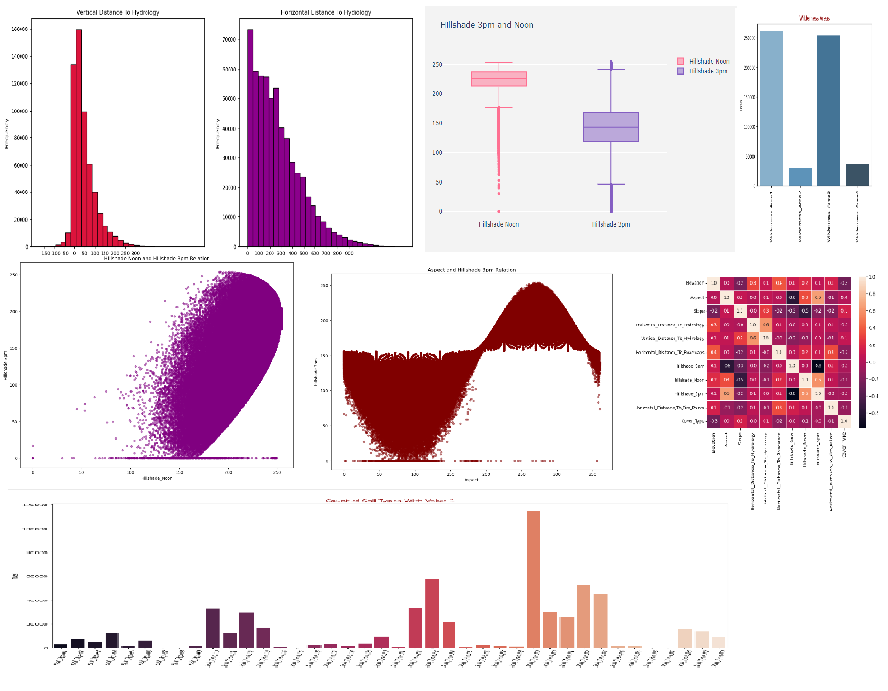

**Content**
1. [Importing Libraries And Loading Datasets](#1)
1. [Exploratory Data Analysis (EDA)](#2)
1. [Data Visualization](#3)
1. [Pandas Profiling](#4)


<a id="1"></a> <br>
## 1. Importing Libraries And Loading Datasets

In [1]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import pandas_profiling as pp
import plotly.graph_objs as go
from plotly.offline import iplot
import plotly.express as px

In [2]:
df = pd.read_csv('/kaggle/input/forest-cover-type-dataset/covtype.csv')


<a id="2"></a> <br>
## 2. Exploratory Data Analysis (EDA)

In [3]:
df.head()

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,...,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
0,2596,51,3,258,0,510,221,232,148,6279,...,0,0,0,0,0,0,0,0,0,5
1,2590,56,2,212,-6,390,220,235,151,6225,...,0,0,0,0,0,0,0,0,0,5
2,2804,139,9,268,65,3180,234,238,135,6121,...,0,0,0,0,0,0,0,0,0,2
3,2785,155,18,242,118,3090,238,238,122,6211,...,0,0,0,0,0,0,0,0,0,2
4,2595,45,2,153,-1,391,220,234,150,6172,...,0,0,0,0,0,0,0,0,0,5


In [4]:
print("Dataset shape: "+ str(df.shape))

Dataset shape: (581012, 55)


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 581012 entries, 0 to 581011
Data columns (total 55 columns):
 #   Column                              Non-Null Count   Dtype
---  ------                              --------------   -----
 0   Elevation                           581012 non-null  int64
 1   Aspect                              581012 non-null  int64
 2   Slope                               581012 non-null  int64
 3   Horizontal_Distance_To_Hydrology    581012 non-null  int64
 4   Vertical_Distance_To_Hydrology      581012 non-null  int64
 5   Horizontal_Distance_To_Roadways     581012 non-null  int64
 6   Hillshade_9am                       581012 non-null  int64
 7   Hillshade_Noon                      581012 non-null  int64
 8   Hillshade_3pm                       581012 non-null  int64
 9   Horizontal_Distance_To_Fire_Points  581012 non-null  int64
 10  Wilderness_Area1                    581012 non-null  int64
 11  Wilderness_Area2                    581012 non-null 

There are total 55 columns in train dataset (54 in test dataset except the last column that is y), All of them are not null.

In [6]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Elevation,581012.0,2959.365301,279.984734,1859.0,2809.0,2996.0,3163.0,3858.0
Aspect,581012.0,155.656807,111.913721,0.0,58.0,127.0,260.0,360.0
Slope,581012.0,14.103704,7.488242,0.0,9.0,13.0,18.0,66.0
Horizontal_Distance_To_Hydrology,581012.0,269.428217,212.549356,0.0,108.0,218.0,384.0,1397.0
Vertical_Distance_To_Hydrology,581012.0,46.418855,58.295232,-173.0,7.0,30.0,69.0,601.0
Horizontal_Distance_To_Roadways,581012.0,2350.146611,1559.254870,0.0,1106.0,1997.0,3328.0,7117.0
Hillshade_9am,581012.0,212.146049,26.769889,0.0,198.0,218.0,231.0,254.0
Hillshade_Noon,581012.0,223.318716,19.768697,0.0,213.0,226.0,237.0,254.0
Hillshade_3pm,581012.0,142.528263,38.274529,0.0,119.0,143.0,168.0,254.0
Horizontal_Distance_To_Fire_Points,581012.0,1980.291226,1324.195210,0.0,1024.0,1710.0,2550.0,7173.0


All Wilderness_Area and Soil_Type columns have values in the range of 0 and 1. Quite likely these columns are categorical and consist of 0 and 1. To validate this i'm checking distinct values of following columns:

In [7]:
print(df.iloc[:,10:-1].columns)

Index(['Wilderness_Area1', 'Wilderness_Area2', 'Wilderness_Area3',
       'Wilderness_Area4', 'Soil_Type1', 'Soil_Type2', 'Soil_Type3',
       'Soil_Type4', 'Soil_Type5', 'Soil_Type6', 'Soil_Type7', 'Soil_Type8',
       'Soil_Type9', 'Soil_Type10', 'Soil_Type11', 'Soil_Type12',
       'Soil_Type13', 'Soil_Type14', 'Soil_Type15', 'Soil_Type16',
       'Soil_Type17', 'Soil_Type18', 'Soil_Type19', 'Soil_Type20',
       'Soil_Type21', 'Soil_Type22', 'Soil_Type23', 'Soil_Type24',
       'Soil_Type25', 'Soil_Type26', 'Soil_Type27', 'Soil_Type28',
       'Soil_Type29', 'Soil_Type30', 'Soil_Type31', 'Soil_Type32',
       'Soil_Type33', 'Soil_Type34', 'Soil_Type35', 'Soil_Type36',
       'Soil_Type37', 'Soil_Type38', 'Soil_Type39', 'Soil_Type40'],
      dtype='object')


In [8]:
pd.unique(df.iloc[:,10:-1].values.ravel())

array([1, 0])

Yes all wilderness area and soil type columns consist of 0 and 1. In other words they are categorical. So i'm convering these columns to categorical ones.

In [9]:
df1=df.copy()

In [10]:
df1.iloc[:,10:-1] = df1.iloc[:,10:-1].astype("category")

I'm trying to find out correlation between columns with heatmap in this step. 

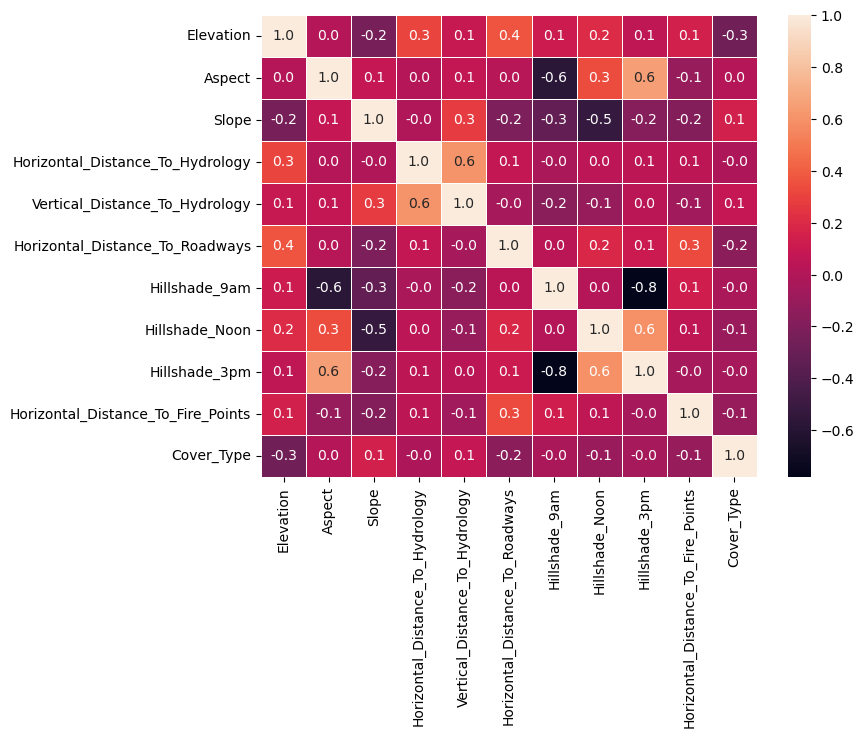

In [11]:
f,ax = plt.subplots(figsize=(8,6))
sns.heatmap(df1.corr(),annot=True, 
            linewidths=.5, fmt='.1f', ax=ax) 

plt.show()

It seems the most important correlations are between "Horizontal Distance To Hydrology" and "Vertical Distance To Hydrology" with 60%;  between "Aspect" and "Hillshade 3pm" with 60%;  between "Hillshade Noon" and "Hillshade 3pm" with %60;  between "Elevation" and "Horizontal Distance To Roadways" with %40. Let's see how they are looking.

<a id="3"></a> <br>
## 3. Data Visualization

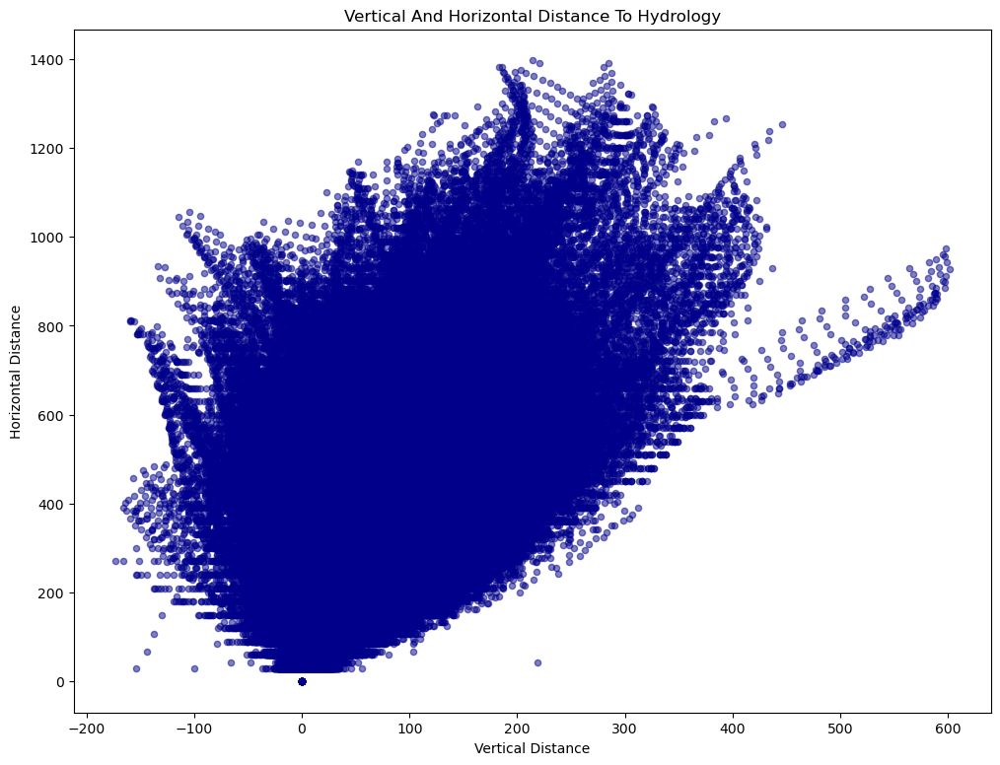

In [12]:
df.plot(kind='scatter', x='Vertical_Distance_To_Hydrology', 
              y='Horizontal_Distance_To_Hydrology', alpha=0.5, 
              color='darkblue', figsize = (12,9))

plt.title('Vertical And Horizontal Distance To Hydrology')
plt.xlabel("Vertical Distance")
plt.ylabel("Horizontal Distance")

plt.show()

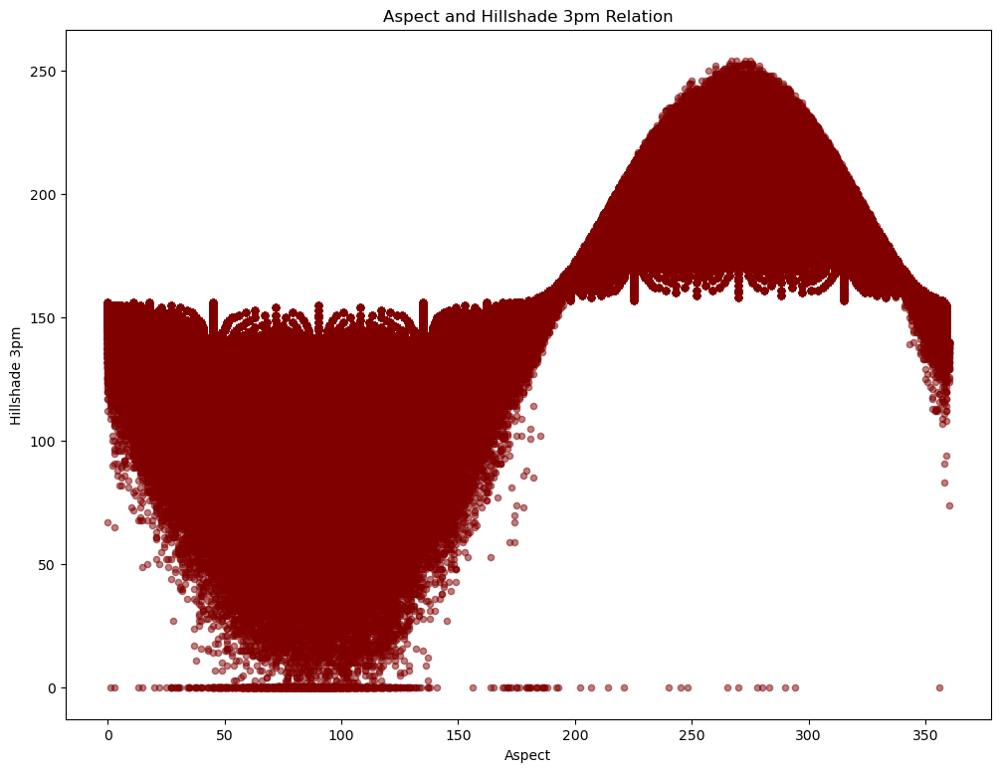

In [13]:
df.plot(kind='scatter', x='Aspect', y='Hillshade_3pm', 
              alpha=0.5, color='maroon', figsize = (12,9))

plt.title('Aspect and Hillshade 3pm Relation')
plt.xlabel("Aspect")
plt.ylabel("Hillshade 3pm")

plt.show()

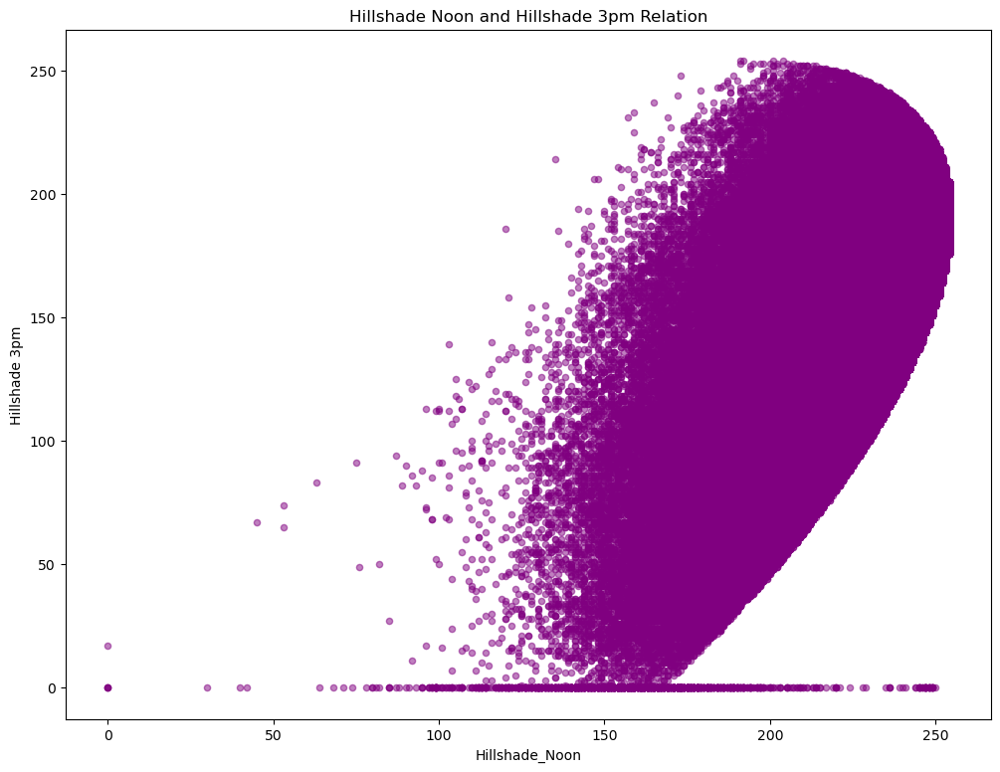

In [14]:
df.plot(kind='scatter', x='Hillshade_Noon', y='Hillshade_3pm', 
              alpha=0.5, color='purple', 
              figsize = (12,9))

plt.title('Hillshade Noon and Hillshade 3pm Relation')
plt.xlabel("Hillshade_Noon")
plt.ylabel("Hillshade 3pm")

plt.show()

There are obvious patterns if we ignore to outliers. And with this patterns, our model will learn.

Boxplot can use to see outliers. For a better visualization i will use plotly this time.

In [15]:
trace1 = go.Box(
    y=df["Vertical_Distance_To_Hydrology"],
    name = 'Vertical Distance',
    marker = dict(color = 'rgb(0,145,119)')
)

trace2 = go.Box(
    y=df["Horizontal_Distance_To_Hydrology"],
    name = 'Horizontal Distance',
    marker = dict(color = 'rgb(5, 79, 174)')
)

data = [trace1, trace2]
layout = dict(autosize=False, width=700,height=500, title='Distance To Hydrology', paper_bgcolor='rgb(243, 243, 243)', 
              plot_bgcolor='rgb(243, 243, 243)', margin=dict(l=40,r=30,b=80,t=100,))

fig = dict(data=data, layout=layout)
iplot(fig)

In [16]:
trace1 = go.Box(
    y=df["Hillshade_Noon"],
    name = 'Hillshade Noon',
    marker = dict(color = 'rgb(255,111,145)')
)

trace2 = go.Box(
    y=df["Hillshade_3pm"],
    name = 'Hillshade 3pm',
    marker = dict(color = 'rgb(132,94,194)')
)

data = [trace1, trace2]
layout = dict(autosize=False, width=700,height=500, title='Hillshade 3pm and Noon', paper_bgcolor='rgb(243, 243, 243)', 
              plot_bgcolor='rgb(243, 243, 243)', margin=dict(l=40,r=30,b=80,t=100,))

fig = dict(data=data, layout=layout)
iplot(fig)

This time i'll compare vertical and horizontal distance to hydrology with histogram.

<function matplotlib.pyplot.show(close=None, block=None)>

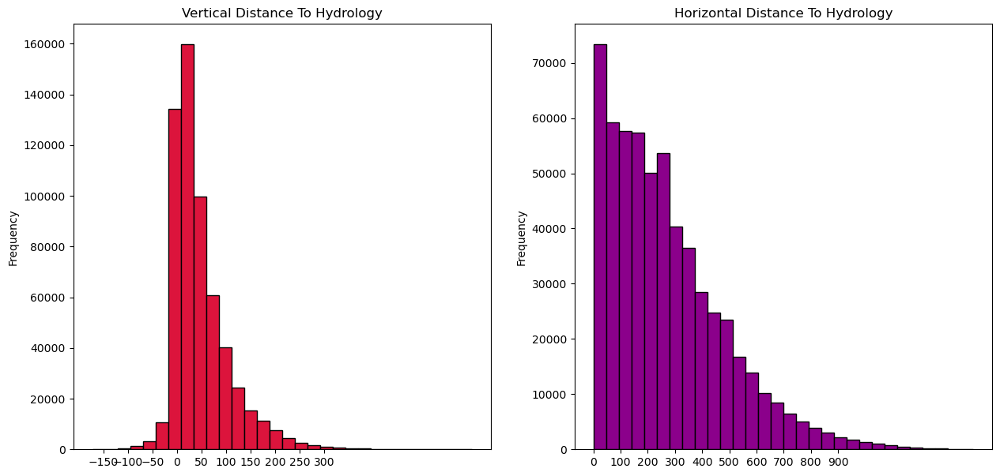

In [17]:
f,ax=plt.subplots(1,2,figsize=(15,7))
df.Vertical_Distance_To_Hydrology.plot.hist(ax=ax[0],bins=30,
                                                  edgecolor='black',color='crimson') 
                                       
ax[0].set_title('Vertical Distance To Hydrology')
x1=list(range(-150,350,50))
ax[0].set_xticks(x1)

df.Horizontal_Distance_To_Hydrology.plot.hist(ax=ax[1],bins=30,
                                                    edgecolor='black',color='darkmagenta') 
                                                                                                        
ax[1].set_title('Horizontal Distance To Hydrology')
x2=list(range(0,1000,100))
ax[1].set_xticks(x2)

plt.show

i'll take a look our categorical categorical variables soil types and wilderness areas.

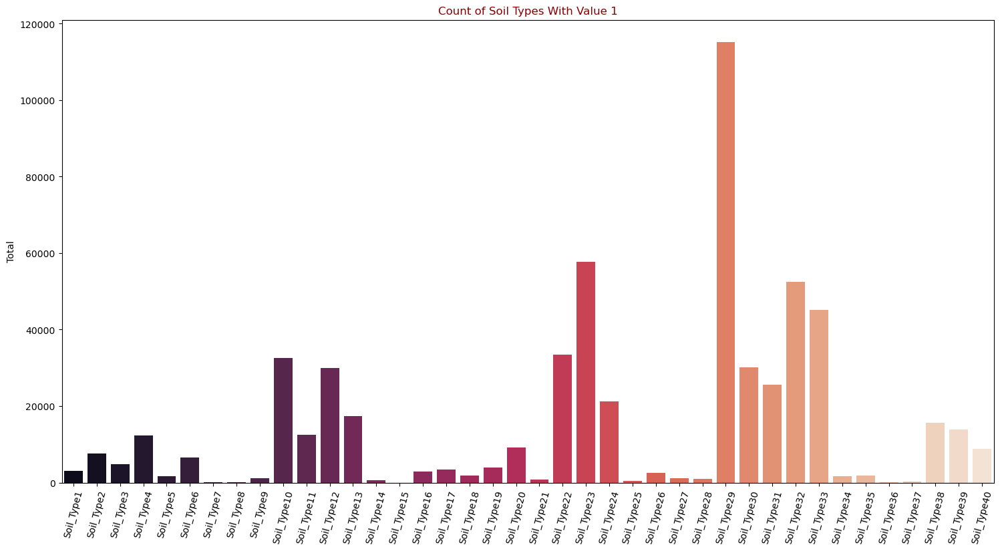

In [18]:
soil_types = df.iloc[:,14:-1].sum(axis=0,numeric_only=True)

plt.figure(figsize=(18,9))
sns.barplot(x=soil_types.index, y=soil_types.values, 
            palette="rocket")

plt.xticks(rotation= 75)
plt.ylabel('Total')
plt.title('Count of Soil Types With Value 1',
          color = 'darkred',fontsize=12)

plt.show()

Type 7, Type 8, Type 15 and Type 25 have either no or too few values. Must examine carefully before create a model.

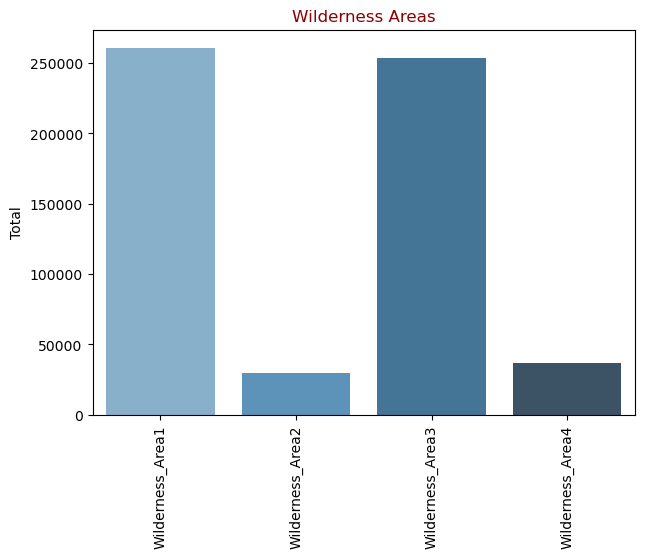

In [19]:
wilderness_areas = df.iloc[:,10:14].sum(axis=0)

plt.figure(figsize=(7,5))
sns.barplot(x=wilderness_areas.index, y=wilderness_areas.values, 
            palette="Blues_d")

plt.xticks(rotation=90)
plt.title('Wilderness Areas',color = 'darkred',fontsize=12)
plt.ylabel('Total')

plt.show()

I wonder how many (y) labels we have in each class. I'll take a look the last column (cover type) for this.

In [20]:
cover_type = df["Cover_Type"].value_counts()
df_cover_type = pd.DataFrame({'CoverType': cover_type.index, 'Total':cover_type.values})

fig = px.bar(df_cover_type, x='CoverType', y='Total', 
             height=400, width=650)

fig.show()

There are same amount of data for each class exactly...

In terms of horizontal distance to x point, distribution of class charts following...

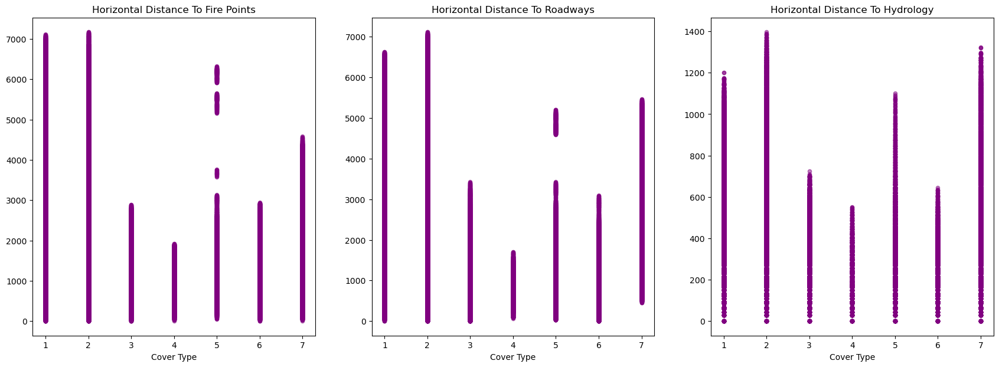

In [21]:
f,ax=plt.subplots(1,3,figsize=(21,7))
df.plot.scatter(ax=ax[0],x='Cover_Type', y='Horizontal_Distance_To_Fire_Points', 
                      alpha=0.5, color='purple')

ax[0].set_title('Horizontal Distance To Fire Points')
x1=list(range(1,8,1))
ax[0].set_ylabel("")
ax[0].set_xlabel("Cover Type")
df.plot.scatter(ax=ax[1],x='Cover_Type', y='Horizontal_Distance_To_Roadways', 
                      alpha=0.5, color='purple')

ax[1].set_title('Horizontal Distance To Roadways')
x2=list(range(1,8,1))
ax[1].set_ylabel("")
ax[1].set_xlabel("Cover Type")
df.plot.scatter(ax=ax[2],x='Cover_Type', y='Horizontal_Distance_To_Hydrology', 
                      alpha=0.5, color='purple')

ax[2].set_title('Horizontal Distance To Hydrology')
x2=list(range(1,8,1))
ax[2].set_ylabel("")
ax[2].set_xlabel("Cover Type")

plt.show()

All of them have a similar pattern, haven't it?

<a id="4"></a> <br>
## 4. Pandas Profiling

Actually there is a faster way for exploratory data analysis. Pandas provides you powerful HTML profiling reports with pandas-profiling. It's like a magic! You can click "Overview", "Variables" etc tabs for a quick run.

In [22]:
report = pp.ProfileReport(df)

report.to_file("report.html")

report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]